# Topic: Team detection based on image embeddings

In [65]:
import os
import warnings 
import plotly.express as px
import numpy as np
import pandas as pd

from ultralytics import YOLO
from PIL import Image


#### Step 1: load image data & trained model

In [66]:
#load images
frame_files = os.listdir('../data/processed/ultimate_detect/images/val/')
frames = [ Image.open('../data/processed/ultimate_detect/images/val/' + frame_file) 
        for frame_file in frame_files]

#load YOLOv8 model

model = YOLO('../model/best.pt')

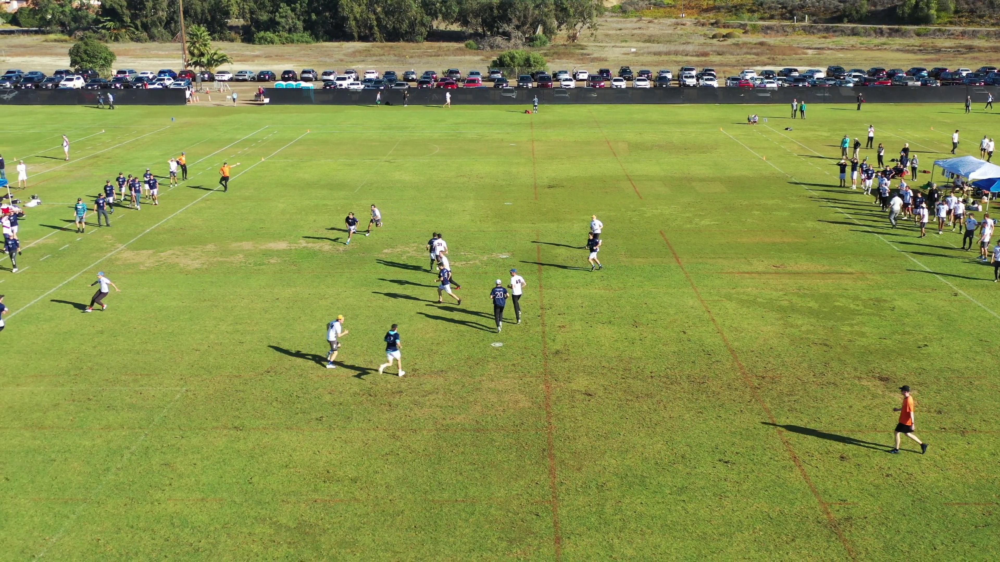

In [67]:
frame = frames[1]
frame

#### Step 2: Extract players using object detection model

In [93]:

#detect players and extract subimages
results = model.track(frame, conf=0.2)

player_imgs = []
for result in results:
    for cls, box in zip(result.boxes.cls.tolist(), result.boxes.xyxy.tolist()):
        if cls == 0:
            print(cls)
            #crop player boxes
            cropped_img = frame.crop(box).resize((128, 256)).crop((30, 30, 98, 100))
            player_imgs.append(cropped_img)       


0: 2176x3840 11 Players, 1 Referee, 4042.8ms
Speed: 87.4ms preprocess, 4042.8ms inference, 2.4ms postprocess per image at shape (1, 3, 2176, 3840)
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


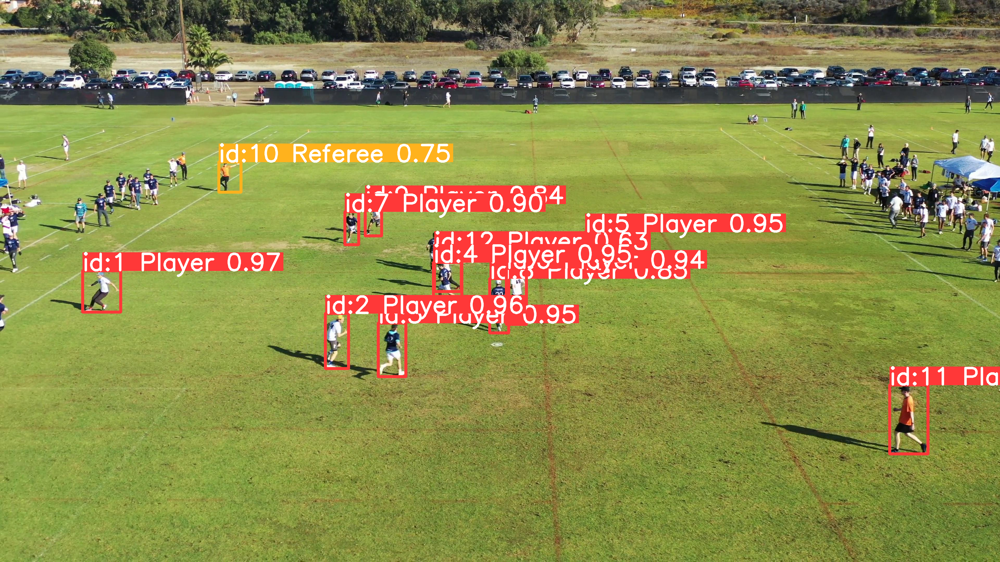

In [79]:
Image.fromarray(results[0].plot()[..., ::-1])

In [94]:
#show extracted players

import plotly.subplots as sp
import plotly.express as px

def plot_list_of_players(img_list:list[Image.Image],pred_labels:list[str] = None):
    fig = sp.make_subplots(rows=1, cols=len(img_list))

    for i, img in enumerate(img_list, start=1):
        fig.add_trace(
            px.imshow(img).data[0],
            row=1, col=i
        )
        
        if pred_labels is not None:
            fig.update_xaxes(title_text=str(pred_labels[i-1]), row=1, col=i)
    
    fig.show()

In [95]:
plot_list_of_players(player_imgs,None)

In [72]:
from sklearn.cluster import KMeans

def train_kmeans(player_imgs: list[Image.Image], 
                 n_colors: int = 3) -> tuple[KMeans, np.ndarray]:
    """ Train a KMeans model to identify the most representative colors (n_colors)
        in a list of images.
        Args:
            player_imgs: list of player images
            n_colors: number of colors to identify in the color palette
        Returns:
            KMeans model
            identified_palette: list of RGB colors identified as the most representative
            
    """
    
    flatten_imgs = [np.array(img).reshape(-1,3) for img in player_imgs]
    pixels_imgs = np.concatenate(flatten_imgs, axis=0)

    kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(pixels_imgs)
    identified_palette = np.array(kmeans.cluster_centers_).astype(int)
    
    return kmeans, identified_palette

def recolor_image(kmeans: KMeans, 
                  player_img: Image.Image) -> Image.Image:
    """ Predict the color palette of the player images using the KMeans model.
        Args:
            kmeans: KMeans model
            player_imgs: list of player images
        Returns:
            Image with the color palette applied
    """
    
    w,h,_ = np.array(player_img).shape
    player_img = np.array(player_img).reshape(-1,3)
    
    labels = kmeans.predict(player_img)
    identified_palette = np.array(kmeans.cluster_centers_).astype(int)
    
    recolored_img = np.copy(player_img)
    for index in range(len(recolored_img)):
        recolored_img[index] = identified_palette[labels[index]]
    recolored_img = recolored_img.reshape(w,h,3)
    
    return Image.fromarray(recolored_img)

def label_image(kmeans: KMeans, player_img: Image.Image) -> int:
    """ Label the images with the color palette applied."""
    w,h,_ = np.array(player_img).shape
    player_img = np.array(player_img).reshape(-1,3)
    
    labels = kmeans.predict(player_img)
    identified_palette = np.array(kmeans.cluster_centers_).astype(int)

    white = [255, 255, 255]
    black = [0, 0, 0]

    def euclidean_distance(c1, c2):
        return sum((a - b) ** 2 for a, b in zip(c1, c2)) ** 0.5
    
    closest_to_white = min(identified_palette, key=lambda color: euclidean_distance(color, white))
    closest_to_black = min(identified_palette, key=lambda color: euclidean_distance(color, black))

    recolored_img = np.copy(player_img)
    for index in range(len(recolored_img)):
        recolored_img[index] = identified_palette[labels[index]]

    count_bright = np.count_nonzero(np.all(recolored_img == closest_to_white, axis=-1))
    count_dark = np.count_nonzero(np.all(recolored_img == closest_to_black, axis=-1))

    if count_bright > count_dark:
        return 1
    else:
        return 0


In [73]:
kmeans, colors = train_kmeans(player_imgs, n_colors=3)
imgs_pred = [label_image(kmeans, img) for img in player_imgs]


In [74]:
plot_list_of_players(player_imgs,imgs_pred)

In [91]:
import cv2

class TeamDetector:
    def __init__(self, img: np.ndarray, detector_results: list) -> None:
        """
        Initialize the TeamDetector object.
        Args:
            img (np.ndarray): The input image.
            detector_results (list['ultralytics.engine.results.Results']): 
        Returns:
            None
        """
        self.img = img
        self.results = detector_results
        self.player_info = []
        for result in self.results:
            for id, cls, box in zip(result.boxes.id, result.boxes.cls.tolist(), result.boxes.xyxy.tolist()):
                if cls == 0:
                    x1, y1, x2, y2 = map(int, box)
                    cropped_img = cv2.resize(self.img[y1:y2, x1:x2], (128, 256))[30:100, 30:98]
                    self.player_info.append({"img": cropped_img, "box": box, "id": int(id)})

    def get_player_images(self) -> list[np.ndarray]:
        """
        Get list of player images.

        Returns:
            List[Image.Image]: A list of player images.
        """
        return [player["img"] for player in self.player_info]
    
    def train_kmeans(self, player_imgs: list[np.ndarray], 
                     n_colors: int = 3) -> tuple[KMeans, np.ndarray]:
        """ Train a KMeans model to identify the most representative colors (n_colors)
            in a list of images.
            Args:
                player_imgs: list of player images
                n_colors: number of colors to identify in the color palette
            Returns:
                KMeans model
                identified_palette: list of RGB colors identified as the most representative

        """

        flatten_imgs = [img.reshape(-1,3) for img in player_imgs]
        pixels_imgs = np.concatenate(flatten_imgs, axis=0)

        kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(pixels_imgs)
        identified_palette = np.array(kmeans.cluster_centers_).astype(int)

        return kmeans, identified_palette
    
    def label_image(self, kmeans: KMeans, player_img: Image.Image) -> int:
        """Label the image with the color palette applied.

            Args:
                kmeans (KMeans): The KMeans model used for color clustering.
                player_img (Image.Image): The image to be labeled.

            Returns:
                int: The label indicating the dominant color in the image. 
                     1 represents a bright color, 0 represents a dark color."""   
             
        player_img = np.array(player_img).reshape(-1,3)
        labels = kmeans.predict(player_img)
        identified_palette = np.array(kmeans.cluster_centers_).astype(int)

        white = [255, 255, 255]
        black = [0, 0, 0]

        def euclidean_distance(c1, c2):
            return sum((a - b) ** 2 for a, b in zip(c1, c2)) ** 0.5

        closest_to_white = min(identified_palette, key=lambda color: euclidean_distance(color, white))
        closest_to_black = min(identified_palette, key=lambda color: euclidean_distance(color, black))

        recolored_img = np.copy(player_img)
        for index in range(len(recolored_img)):
            recolored_img[index] = identified_palette[labels[index]]

        count_bright = np.count_nonzero(np.all(recolored_img == closest_to_white, axis=-1))
        count_dark = np.count_nonzero(np.all(recolored_img == closest_to_black, axis=-1))

        if count_bright > count_dark:
            return 1
        else:
            return 0
        
    def predict_player_clusters(self, kmeans: KMeans, player_imgs: list[np.ndarray]) -> pd.DataFrame:
        """
        Predict the team of each player based on the color clustering.
        Args:
            kmeans: KMeans model
            player_imgs: list of player images
        Returns:
            pd.DataFrame: A dataframe containing the player id and the predicted team.
        """
        ids = [player['id'] for player in self.player_info if 'id' in player]
        pred_labels = [self.label_image(kmeans, player_img) for player_img in player_imgs]

        return pd.DataFrame({ 'id': ids, 'pred_team': pred_labels})


detector = TeamDetector(np.array(frame), results)
player_images = detector.get_player_images()
kmeans, _ = detector.train_kmeans(player_images, n_colors=3)
pred = detector.predict_player_clusters(kmeans, player_images)
pred


,id,pred_team
0,1,1
1,2,1
2,3,0
3,4,0
4,5,0
5,6,1
6,7,0
7,8,0
8,9,1
9,11,0


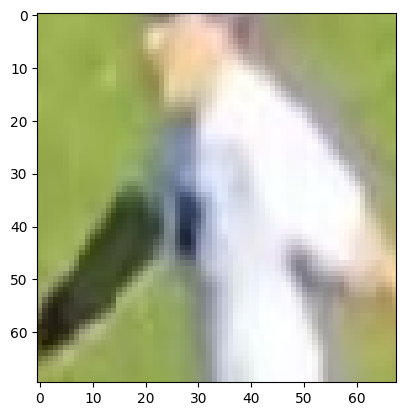

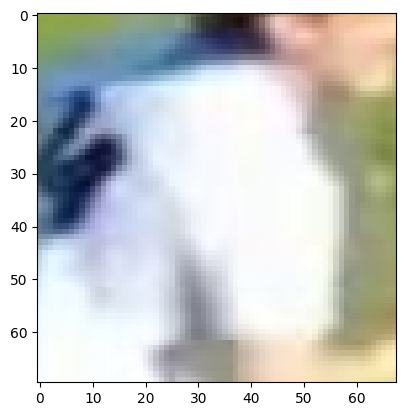

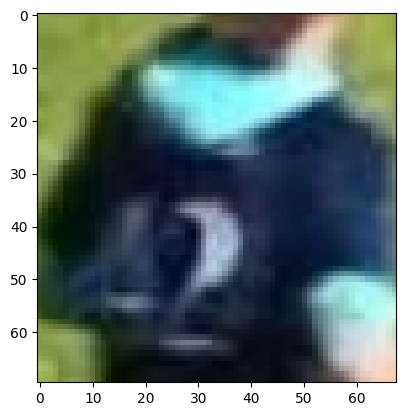

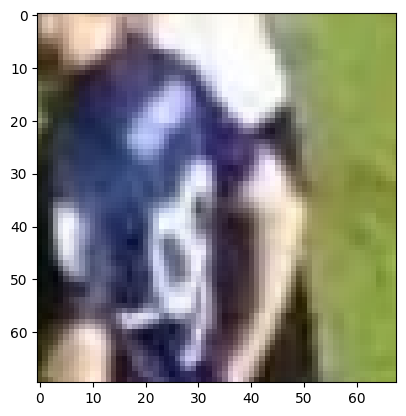

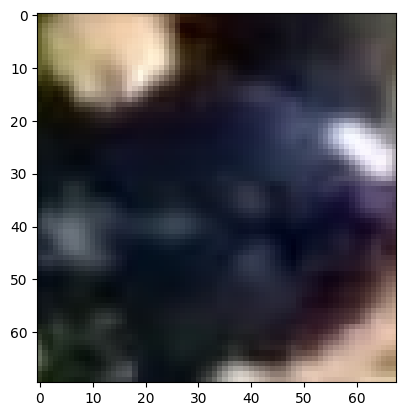

...

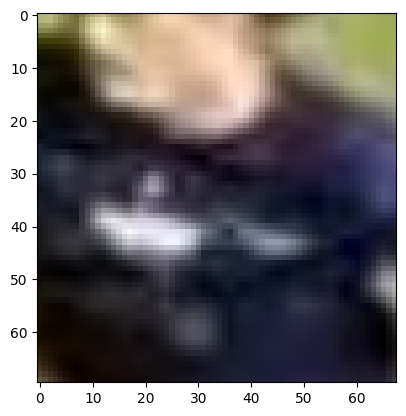

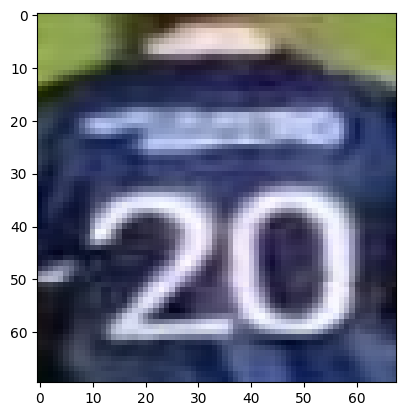

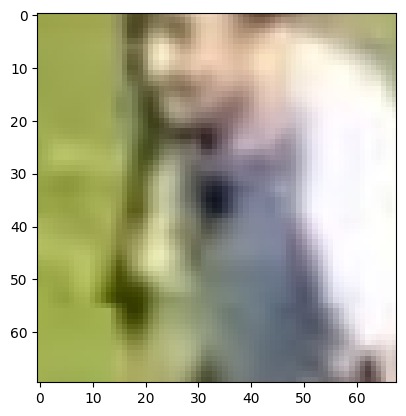

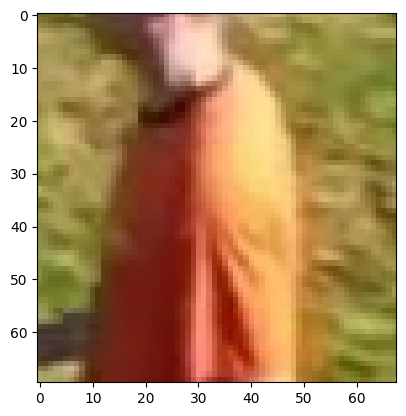

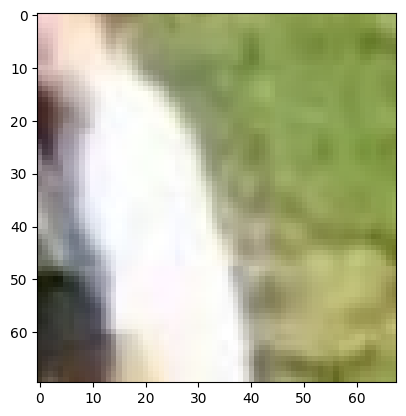

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Player', 1: 'Disc', 2: 'Field', 3: 'Referee'}
 obb: None
 orig_img: array([[[148, 175, 172],
         [154, 181, 178],
         [162, 189, 186],
         ...,
         [ 75,  99,  99],
         [ 73,  97,  97],
         [ 64,  88,  88]],
 
        [[165, 191, 191],
         [167, 193, 193],
         [169, 195, 195],
         ...,
         [ 79, 103, 103],
         [ 78, 102, 102],
         [ 70,  94,  94]],
 
        [[180, 203, 205],
         [177, 200, 202],
         [172, 195, 197],
         ...,
         [ 82, 106, 106],
         [ 83, 107, 107],
         [ 77, 101, 101]],
 
        ...,
 
        [[ 55, 153, 131],
         [ 56, 154, 132],
         [ 58, 156, 134],
         ...,
         [ 30, 117,  97],
         [ 36, 123, 103],
         [ 42, 129, 109]],
 
        [[ 58, 156, 134],
         [ 59, 157, 135],
         [ 60, 158, 1